In [1]:
!pip install awswrangler

import awswrangler as wr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

pd.set_option('display.max_rows', 1500)
pd.set_option('display.max_columns', 500)
pd.options.display.float_format = '{:,.4f}'.format

Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com


In [ ]:
df = wr.s3.read_csv('s3://dsp-data-vq22301/final_dataset_drop_target_na.csv')

In [ ]:
df = wr.s3.read_csv('s3://dsp-data-vq22301/final_dataset_with_cap.csv')

# EDA and Data Understanding

## Notes from the Manual:

 - As many of the ratios studied here are void of economic meanings among the finance companies, we have hence excluded these firms from our universe. 
 - **Theme Classification** WIFR collects over 70 different financial ratios, categorized based on the economic intuition into the following seven groups:
1. Capitalization: measures the debt component of a firm’s total capital structure, e.g.: Capitalization Ratio, Total Debt-to-Invested Capital Ratio;
2. Efficiency: captures the effectiveness of firm’s usage of assets and liability, e.g.: Asset Turnover, Inventory Turnover;
3. Financial Soundness/Solvency: captures the firm’s ability to meet long-term obligations, e.g.: Total Debt to Equity Ratio, Interest Coverage Ratio;
4. Liquidity: measures a firm’s ability to meet its short-term obligations, e.g.: Current Ratio, Quick Ratio;
5. Profitability: measures the ability of a firm to generate profit, e.g.: ROA, Gross Profit Margin;
6. Valuation: estimates the attractiveness of a firm’s stock (overpriced or underpriced), e.g.: P/E ratio, Shiller’s CAPE ratio;
7. Others: Miscellaneous ratios, e.g.: R&D-to-Sales, Labor Expenses-to-Sales.
 - In order to populate the data to monthly frequency, we carry forward the most recent quarterly or annual data item, whichever is most recently available at a given time stamp, to the subsequent months before the next filing data becomes available.
 - To avoid look ahead bias and ensure that all data is publicly available at the monthly time stamp, we lag all observations by two months to avoid any lookahead bias.
 - **Outlier Control**: Outlier controls not applied to raw firm ratios. Therefore, researchers advised to censor/smooth before processing.

## Cleaning

Drop unnecessary columns...

In [3]:
df = df.drop(columns=['Unnamed: 0.1', 'Unnamed: 0', 'Unnamed: 0.2', 'Unnamed: 0.3'])

Set a glossary for the variables names, category and formula.

In [4]:
glossary = {
    'CAPEI': {'Ratio': 'Shillers Cyclically Adjusted P/E Ratio', 'Category': 'Valuation', 'Formula': 'Multiple of Market Value of Equity to 5-year moving average of Net Income'},
    'bm': {'Ratio': 'Book/Market', 'Category': 'Valuation', 'Formula': 'Book Value of Equity as a fraction of Market Value of Equity'},
    'evm': {'Ratio': 'Enterprise Value Multiple', 'Category': 'Valuation', 'Formula': 'Multiple of Enterprise Value to EBITDA'},
    'pe_op_basic': {'Ratio': 'Price/Operating Earnings (Basic, Excl. EI)', 'Category': 'Valuation', 'Formula': 'Price to Operating EPS, excl. Extraordinary Items (Basic)'},
    'pe_op_dil': {'Ratio': 'Price/Operating Earnings (Diluted, Excl. EI)', 'Category': 'Valuation', 'Formula': 'Price to Operating EPS, excl. Extraordinary Items (Diluted)'},
    'pe_exi': {'Ratio': 'P/E (Diluted, Excl. EI)', 'Category': 'Valuation', 'Formula': 'Price-to-Earnings, excl. Extraordinary Items (diluted)'},
    'pe_inc': {'Ratio': 'P/E (Diluted, Incl. EI)', 'Category': 'Valuation', 'Formula': 'Price-to-Earnings, incl. Extraordinary Items (diluted)'},
    'ps': {'Ratio': 'Price/Sales', 'Category': 'Valuation', 'Formula': 'Multiple of Market Value of Equity to Sales'},
    'pcf': {'Ratio': 'Price/Cash flow', 'Category': 'Valuation', 'Formula': 'Multiple of Market Value of Equity to Net Cash Flow from Operating Activities'},
    'dpr': {'Ratio': 'Dividend Payout Ratio', 'Category': 'Valuation', 'Formula': 'Dividends as a fraction of Income Before Extra. Items'},
    'npm': {'Ratio': 'Net Profit Margin', 'Category': 'Profitability', 'Formula': 'Net Income as a fraction of Sales'},
    'opmbd': {'Ratio': 'Operating Profit Margin Before Depreciation', 'Category': 'Profitability', 'Formula': 'Operating Income Before Depreciation as a fraction of Sales'},
    'opmad': {'Ratio': 'Operating Profit Margin After Depreciation', 'Category': 'Profitability', 'Formula': 'Operating Income After Depreciation as a fraction of Sales'},
    'gpm': {'Ratio': 'Gross Profit Margin', 'Category': 'Profitability', 'Formula': 'Gross Profit as a fraction of Sales'},
    'ptpm': {'Ratio': 'Pre-tax Profit Margin', 'Category': 'Profitability', 'Formula': 'Pretax Income as a fraction of Sales'},
    'cfm': {'Ratio': 'Cash Flow Margin', 'Category': 'Financial Soundness', 'Formula': 'Income before Extraordinary Items and Depreciation as a fraction of Sales'},
    'roa': {'Ratio': 'Return on Assets', 'Category': 'Profitability', 'Formula': 'Operating Income Before Depreciation as a fraction of average TotalAssets based on most recent two periods'},
    'roe': {'Ratio': 'Return on Equity', 'Category': 'Profitability', 'Formula': 'Net Income as a fraction of average Book Equity based on most recent two periods, where Book Equity is defined as the sum of Total Parent Stockholders Equity and Deferred Taxes and Investment Tax Credit'},
    'roce': {'Ratio': 'Return on Capital Employed', 'Category': 'Profitability', 'Formula': 'Earnings Before Interest and Taxes as a fraction of average Capital Employed based on most recent two periods, where Capital Employed is the sum of Debt in Long-term and Current Liabilities and Common/Ordinary Equity'},
    'efftax': {'Ratio': 'Effective Tax Rate', 'Category': 'Profitability', 'Formula': 'Income Tax as a fraction of Pretax Income'},
    'aftret_eq': {'Ratio': 'After-tax Return on Average Common Equity', 'Category': 'Profitability', 'Formula': 'Net Income as a fraction of average of Common Equity based on most recent two periods'},
    'aftret_invcapx': {'Ratio': 'After-tax Return on Invested Capital', 'Category': 'Profitability', 'Formula': 'Net Income plus Interest Expenses as a fraction of Invested Capital'},
    'aftret_equity': {'Ratio': 'After-tax Return on Total Stockholders’ Equity', 'Category': 'Profitability', 'Formula': 'Net Income as a fraction of average of Total Shareholders’ Equity based on most recent two periods'},
    'pretret_noa': {'Ratio': 'Pre-tax return on Net Operating Assets', 'Category': 'Profitability', 'Formula': 'Operating Income After Depreciation as a fraction of average Net Operating Assets (NOA) based on most recent two periods, where NOA is defined as the sum of Property Plant and Equipment and Current Assets minus Current Liabilities'},
    'pretret_earnat': {'Ratio': 'Pre-tax Return on Total Earning Assets', 'Category': 'Profitability', 'Formula': 'Operating Income After Depreciation as a fraction of average Total Earnings Assets (TEA) based on most recent two periods, where TEA is defined as the sum of Property Plant and Equipment and Current Assets'},
    'GProf': {'Ratio': 'Gross Profit/Total Assets', 'Category': 'Profitability', 'Formula': 'Gross Profitability as a fraction of Total Assets'},
    'equity_invcap': {'Ratio': 'Common Equity/Invested Capital', 'Category': 'Capitalisation', 'Formula': 'Common Equity as a fraction of Invested Capital'},
    'debt_invcap': {'Ratio': 'Long-term Debt/Invested Capital', 'Category': 'Capitalisation', 'Formula': 'Long-term Debt as a fraction of Invested Capital'},
    'totdebt_invcap': {'Ratio': 'Total Debt/Invested Capital', 'Category': 'Capitalisation', 'Formula': 'Total Debt (Long-term and Current) as a fraction of Invested Capital'},
    'capital_ratio': {'Ratio': 'Capitalization Ratio', 'Category': 'Capitalisation', 'Formula': 'Total Long-term Debt as a fraction of the sum of Total Long-term Debt, Common/Ordinary Equity and Preferred Stock'},
    'int_debt': {'Ratio': 'Interest/Average Long-term Debt', 'Category': 'Financial Soundness', 'Formula': 'Interest as a fraction of average Long-term debt based on most recent two periods'},
    'int_totdebt': {'Ratio': 'Interest/Average Total Debt', 'Category': 'Financial Soundness', 'Formula': 'Interest as a fraction of average Total Debt based on most recent two periods'},
    'cash_lt': {'Ratio': 'Cash Balance/Total Liabilities', 'Category': 'Financial Soundness', 'Formula': 'Cash Balance as a fraction of Total Liabilities'},
    'invt_act': {'Ratio': 'Inventory/Current Assets', 'Category': 'Financial Soundness', 'Formula': 'Inventories as a fraction of Current Assets'},
    'rect_act': {'Ratio': 'Receivables/Current Assets', 'Category': 'Financial Soundness', 'Formula': 'Accounts Receivables as a fraction of Current Assets'},
    'debt_at': {'Ratio': 'Total Debt/Total Assets', 'Category': 'Solvency', 'Formula': 'Total Liabilities as a fraction of Total Assets'},
    'debt_ebitda': {'Ratio': 'debt_ebitda', 'Category': 'Financial Soundness', 'Formula': 'Gross Debt as a fraction of EBITDA'},
    'short_debt': {'Ratio': 'Short-Term Debt/Total Debt', 'Category': 'Financial Soundness', 'Formula': 'Short-term Debt as a fraction of Total Debt'},
    'curr_debt': {'Ratio': 'Current Liabilities/Total Liabilities', 'Category': 'Financial Soundness', 'Formula': 'Current Liabilities as a fraction of Total Liabilities'},
    'lt_debt': {'Ratio': 'Long-term Debt/Total Liabilities', 'Category': 'Financial Soundness', 'Formula': 'Long-term Debt as a fraction of Total Liabilities'},
    'profit_lct': {'Ratio': 'Profit Before Depreciation/Current Liabilities', 'Category': 'Financial Soundness', 'Formula': 'Operating Income before D&A as a fraction of Current Liabilities'},
    'ocf_lct': {'Ratio': 'Operating CF/Current Liabilities', 'Category': 'Financial Soundess', 'Formula': 'Operating Cash Flow as a fraction of Current Liabilities'},
    'cash_debt': {'Ratio': 'Cash Flow/Total Debt', 'Category': 'Financial Soundness', 'Formula': 'Operating Cash Flow as a fraction of Total Debt'},
    'fcf_ocf': {'Ratio': 'Free Cash Flow/Operating Cash Flow', 'Category': 'Financial Soundness', 'Formula': 'Free Cash Flow as a fraction of Operating Cash Flow, where Free Cash Flow is defined as the difference between Operating Cash Flow and Capital Expenditures'},
    'lt_ppent': {'Ratio': 'Total Liabilities/Total Tangible Assets', 'Category': 'Financial Soundness', 'Formula': 'Total Liabilities to Total Tangible Assets'},
    'dltt_be': {'Ratio': 'Long-term Debt/Book Equity', 'Category': 'Financial Soundess', 'Formula': 'Long-term Debt to Book Equity'},
    'debt_assets': {'Ratio': 'Total Debt/Total Assets', 'Category': 'Solvency', 'Formula': 'Total Debt as a fraction of Total Assets'},
    'debt_capital': {'Ratio': 'Total Debt/Capital', 'Category': 'Solvency', 'Formula': 'Total Debt as a fraction of Total Capital, where Total Debt is defined as the sum of Accounts Payable and Total Debt in Current and Long-term Liabilities, and Total Capital is defined as the sum of Total Debt and Total Equity (common and preferred)'},
    'de_ratio': {'Ratio': 'Total Debt/Equity', 'Category': 'Solvency', 'Formula': 'Total Liabilities to Shareholders’ Equity (common and preferred)'},
    'intcov': {'Ratio': 'After-tax Interest Coverage', 'Category': 'Solvency', 'Formula': 'Multiple of After-tax Income to Interest and Related Expenses'},
    'intcov_ratio': {'Ratio': 'Interest Coverage Ratio', 'Category': 'Solvency', 'Formula': 'Multiple of Earnings Before Interest and Taxes to Interest and Related Expenses'},
    'cash_ratio': {'Ratio': 'Cash Ratio', 'Category': 'Liquidity', 'Formula': 'Cash and Short-term Investments as a fraction of Current Liabilities'},
    'quick_ratio': {'Ratio': 'Quick Ratio (Acid Test)', 'Category': 'Liquidity', 'Formula': 'Quick Ratio: Current Assets net of Inventories as a fraction of Current Liabilities'},
    'curr_ratio': {'Ratio': 'Current Ratio', 'Category': 'Liquidity', 'Formula': 'Current Assets as a fraction of Current Liabilities'},
    'cash_conversion': {'Ratio': 'Cash Conversion Cycle (Days)', 'Category': 'Liquidity', 'Formula': 'Inventories per daily COGS plus Account Receivables per daily Sales minus Account Payables per daily COGS'},
    'inv_turn': {'Ratio': 'Inventory Turnover', 'Category': 'Efficiency', 'Formula': 'COGS as a fraction of the average Inventories based on the most recent two periods'},
    'at_turn': {'Ratio': 'Asset Turnover', 'Category': 'Efficiency', 'Formula': 'Sales as a fraction of the average Total Assets based on the most recent two periods'},
    'rect_turn': {'Ratio': 'Receivables Turnover', 'Category': 'Efficiency', 'Formula': 'Sales as a fraction of the average of Accounts Receivables based on the most recent two periods'},
    'pay_turn': {'Ratio': 'Payables Turnover', 'Category': 'Efficiency', 'Formula': 'COGS and change in Inventories as a fraction of the average of Accounts Payable based on the most recent two periods'},
    'sale_invcap': {'Ratio': 'Sales/Invested Capital', 'Category': 'Efficiency', 'Formula': 'Sales per dollar of Invested Capital'},
    'sale_equity': {'Ratio': 'Sales/Stockholders Equity', 'Category': 'Efficiency', 'Formula': 'Sales per dollar of total Stockholders’ Equity'},
    'sale_nwc': {'Ratio': 'Sales/Working Capital', 'Category': 'Efficiency', 'Formula': 'Sales per dollar of Working Capital, defined as difference between Current Assets and Current Liabilities'},
    'rd_sale': {'Ratio': 'Research and Development/Sales', 'Category': 'Other', 'Formula': 'R&D expenses as a fraction of Sales'},
    'adv_sale': {'Ratio': 'Avertising Expenses/Sales', 'Category': 'Other', 'Formula': 'Advertising Expenses as a fraction of Sales'},
    'staff_sale': {'Ratio': 'Labor Expenses/Sales', 'Category': 'Other', 'Formula': 'Labor Expenses as a fraction of Sales'},
    'accrual': {'Ratio': 'Accruals/Average Assets', 'Category': 'Other', 'Formula': 'Accruals as a fraction of average Total Assets based on most recent two periods'},
    'ptb': {'Ratio': 'Price/Book', 'Category': 'Valuation', 'Formula': 'Multiple of Market Value of Equity to Book Value of Equity'},
    'PEG_trailing': {'Ratio': 'Trailing P/E to Growth (PEG) ratio', 'Category': 'Valuation', 'Formula': 'Price-to-Earnings, excl. Extraordinary Items (diluted) to 3-Year past EPS Growth'},
    'divyield': {'Ratio': 'Dividend Yield', 'Category': 'Valuation', 'Formula': 'Indicated Dividend Rate as a fraction of Price'}
}

Create a separate dataframe with just the input variables and target variable (1yr return).

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498891 entries, 0 to 2498890
Data columns (total 97 columns):
 #   Column           Dtype  
---  ------           -----  
 0   Unnamed: 0       int64  
 1   gvkey            float64
 2   permno           float64
 3   adate            object 
 4   qdate            object 
 5   public_date      object 
 6   CAPEI            float64
 7   bm               float64
 8   evm              float64
 9   pe_op_basic      float64
 10  pe_op_dil        float64
 11  pe_exi           float64
 12  pe_inc           float64
 13  ps               float64
 14  pcf              float64
 15  dpr              float64
 16  npm              float64
 17  opmbd            float64
 18  opmad            float64
 19  gpm              float64
 20  ptpm             float64
 21  cfm              float64
 22  roa              float64
 23  roe              float64
 24  roce             float64
 25  efftax           float64
 26  aftret_eq        float64
 27  aftret_invca

The variable 'divyield' is a % but is formatted as a string in the dataset. We will need to change this to a float.

In [27]:
transformed_divyield = df.divyield.copy()

for j, i in enumerate(transformed_divyield):
    if pd.isna(i):
        transformed_divyield[j] = 0.0  # nans are actually 0% yield.
    else:
        transformed_divyield[j] = float(i[:-1]) / 100
        
df['divyield'] = transformed_divyield.astype('float64')

In [6]:
io = df[['CAPEI', 'bm',
       'evm', 'pe_op_basic', 'pe_op_dil', 'pe_exi', 'pe_inc', 'ps', 'pcf',
       'dpr', 'npm', 'opmbd', 'opmad', 'gpm', 'ptpm', 'cfm', 'roa', 'roe',
       'roce', 'efftax', 'aftret_eq', 'aftret_invcapx', 'aftret_equity',
       'pretret_noa', 'pretret_earnat', 'GProf', 'equity_invcap',
       'debt_invcap', 'totdebt_invcap', 'capital_ratio', 'int_debt',
       'int_totdebt', 'cash_lt', 'invt_act', 'rect_act', 'debt_at',
       'debt_ebitda', 'short_debt', 'curr_debt', 'lt_debt', 'profit_lct',
       'ocf_lct', 'cash_debt', 'fcf_ocf', 'lt_ppent', 'dltt_be', 'debt_assets',
       'debt_capital', 'de_ratio', 'intcov', 'intcov_ratio', 'cash_ratio',
       'quick_ratio', 'curr_ratio', 'cash_conversion', 'inv_turn', 'at_turn',
       'rect_turn', 'pay_turn', 'sale_invcap', 'sale_equity', 'sale_nwc',
       'rd_sale', 'adv_sale', 'staff_sale', 'accrual', 'ptb', 'PEG_trailing',
       'divyield', 'MthCap', 'FEDFUNDS', '1yr_inf_rate', '1mo_inf_rate', '1yr_GDP', '1mo_GDP', 'DGS10', '1yr_return']]

## Missing Data

In [34]:
io.isnull().sum()

CAPEI               289560
bm                  102700
evm                  71675
pe_op_basic         857977
pe_op_dil          1447613
pe_exi              236473
pe_inc              238219
ps                   92783
pcf                  93162
dpr                 652628
npm                  92807
opmbd                93368
opmad                93224
gpm                  96005
ptpm                 92938
cfm                 151406
roa                  99295
roe                 158285
roce                131655
efftax              699708
aftret_eq            90897
aftret_invcapx      116315
aftret_equity        93764
pretret_noa         445679
pretret_earnat      443089
GProf                62907
equity_invcap        61464
debt_invcap          70351
totdebt_invcap       74990
capital_ratio        62526
int_debt            668739
int_totdebt         597780
cash_lt              66314
invt_act            429293
rect_act            422787
debt_at              67472
debt_ebitda          80534
s

The below cell loops through the variables and gives a snapshot of the nan lines for that variable to see if any can be marked as 0 or anything should be changed in the dataset.

In [22]:
from IPython.display import clear_output
for column in io.columns:
    print(f'{column}\n')
    for i in glossary[column]:
        print(f'{i}: {glossary[column][i]}')
    print(f'\n{len(io[io[column].isnull()])}')
    display(df[df[column].isnull()].head(500))
    wait = input('Press enter to continue...')
    clear_output()

pcf

Ratio: Price/Cash flow
Category: Valuation
Formula: Multiple of Market Value of Equity to Net Cash Flow from Operating Activities

93162


,gvkey,permno,adate,qdate,public_date,CAPEI,bm,evm,pe_op_basic,pe_op_dil,pe_exi,pe_inc,ps,pcf,dpr,npm,opmbd,opmad,gpm,ptpm,cfm,roa,roe,roce,efftax,aftret_eq,aftret_invcapx,aftret_equity,pretret_noa,pretret_earnat,GProf,equity_invcap,debt_invcap,totdebt_invcap,capital_ratio,int_debt,int_totdebt,cash_lt,invt_act,rect_act,debt_at,debt_ebitda,short_debt,curr_debt,lt_debt,profit_lct,ocf_lct,cash_debt,fcf_ocf,lt_ppent,dltt_be,debt_assets,debt_capital,de_ratio,intcov,intcov_ratio,cash_ratio,quick_ratio,curr_ratio,cash_conversion,inv_turn,at_turn,rect_turn,pay_turn,sale_invcap,sale_equity,sale_nwc,rd_sale,adv_sale,staff_sale,accrual,ptb,PEG_trailing,divyield,TICKER,cusip,Year,Month,PrimaryExch,SecurityNm,Ticker,MthCalDt,MthPrc,MthCap,MthVol,MthPrcVol,1yr_return,FEDFUNDS,USACPIALLMINMEI,1yr_inf_rate,1mo_inf_rate,GDP,1yr_GDP,1mo_GDP,DGS10
76,"1,001.0000","10,015.0000",NaN,1983-09-30,1983-11-30,NaN,0.1250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.7760,NaN,NaN,AMFD,00016510,"1,983.0000",11.0000,Q,A & M FOOD SERVICES INC; COM NONE; CONS,AMFD,1983-11-30,8.1250,"28,990.0000","197,710.0000","1,533,275.9000",-0.5462,9.4700,42.7396,0.0379,0.0010,"3,794.7060",0.1152,0.0000,11.6300
77,"1,001.0000","10,015.0000",NaN,1983-09-30,1983-12-31,NaN,0.1250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.6470,NaN,NaN,AMFD,00016510,"1,983.0000",12.0000,Q,A & M FOOD SERVICES INC; COM NONE; CONS,AMFD,1983-12-30,7.5000,"26,775.0000","176,251.0000","1,343,346.3000",-0.4917,9.5600,42.9927,0.0419,0.0059,"3,908.0540",0.1251,0.0299,11.8200
78,"1,001.0000","10,015.0000",NaN,1983-09-30,1984-01-31,NaN,0.1250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0110,NaN,NaN,AMFD,00016510,"1,984.0000",1.0000,Q,A & M FOOD SERVICES INC; COM NONE; CONS,AMFD,1984-01-31,8.2500,"29,452.5000","160,853.0000","1,340,595.8000",-0.3939,9.5900,43.2037,0.0460,0.0049,"3,908.0540",0.1251,0.0000,11.6700
120,"1,003.0000","10,031.0000",NaN,1985-10-31,1986-02-28,13.5500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ANTQ,00035410,"1,986.0000",2.0000,Q,A A IMPORTING INC; COM NONE; CONS,ANTQ,1986-02-28,4.6250,"12,408.8800","12,700.0000","59,562.5000",-0.0270,7.4800,45.9039,0.0226,-0.0046,"4,507.8940",0.0657,0.0000,8.1300
121,"1,003.0000","10,031.0000",1986-01-31,1986-01-31,1986-03-31,18.0450,0.5520,16.1750,NaN,NaN,44.4440,44.4440,0.4850,NaN,0.0000,0.0100,0.0430,0.0270,0.4270,0.0160,0.0250,NaN,NaN,NaN,0.3870,NaN,NaN,NaN,NaN,NaN,0.7380,0.5870,0.4130,0.4140,0.4130,NaN,NaN,0.0010,0.8890,0.0890,0.3360,4.5320,0.0040,0.3610,0.6390,0.3920,NaN,NaN,NaN,8.2030,0.7020,0.5240,0.4650,1.0990,1.8640,2.4100,0.0020,0.5250,4.7140,NaN,NaN,NaN,NaN,NaN,2.1320,3.6290,2.4640,0.0000,0.0420,0.0000,NaN,1.7610,NaN,NaN,ANTQ,00035410,"1,986.0000",3.0000,Q,A A IMPORTING INC; COM NONE; CONS,ANTQ,1986-03-31,4.3750,"11,738.1300","107,650.0000","460,470.6000",0.0286,6.9900,45.8195,0.0159,-0.0018,"4,545.3400",0.0583,0.0083,7.3900
122,"1,003.0000","10,031.0000",1986-01-31,1986-01-31,1986-04-30,19.5910,0.5520,16.1750,NaN,NaN,50.0000,50.0000,0.5270,NaN,0.0000,0.0100,0.0430,0.0270,0.4270,0.0160,0.0250,NaN,NaN,NaN,0.3870,NaN,NaN,NaN,NaN,NaN,0.7380,0.5870,0.4130,0.4140,0.4130,NaN,NaN,0.001

KeyboardInterrupt: Interrupted by user

There are many lines where there are lots of missing values (most where there is no corresponding adate). These are likely to skew our analysis and therefore let's drop lines with >70% missing values.

In [60]:
import time

start_time = time.time()

for i in range(len(io)):
    if i % 100000 == 0:
        print(i, time.time() - start_time)
    if io.iloc[i, :].isnull().sum()/len(io.iloc[i, :]) > 0.7:
        io.loc[i, 'delete'] = 1
    else:
        io.loc[i, 'delete'] = 0

0 0.00010776519775390625
100000 39.960909843444824
200000 79.80208849906921
300000 119.5726945400238
400000 159.67613530158997
500000 199.84736919403076
600000 239.60574007034302
700000 279.5415759086609
800000 319.41029834747314
900000 359.59611225128174
1000000 399.7990458011627
1100000 439.9717402458191
1200000 479.96996879577637
1300000 519.9542443752289
1400000 560.4101696014404
1500000 600.3553445339203
1600000 640.4453055858612
1700000 680.47514128685
1800000 720.4846315383911
1900000 760.6049301624298
2000000 800.5328285694122
2100000 840.6684691905975
2200000 880.6625349521637
2300000 920.6530091762543
2400000 960.5183527469635


In [64]:
io[io['delete'] == 0].isnull().sum()

CAPEI               236544
bm                   59492
evm                  13370
pe_op_basic         799681
pe_op_dil          1389314
pe_exi              180567
pe_inc              182310
ps                   34507
pcf                  34860
dpr                 596569
npm                  34531
opmbd                35081
opmad                34934
gpm                  37718
ptpm                 34660
cfm                  93104
roa                  41002
roe                 104903
roce                 73365
efftax              641415
aftret_eq            37491
aftret_invcapx       60453
aftret_equity        40358
pretret_noa         387386
pretret_earnat      384796
GProf                 4614
equity_invcap         8965
debt_invcap          12201
totdebt_invcap       16818
capital_ratio         4299
int_debt            610434
int_totdebt         539475
cash_lt               8141
invt_act            370988
rect_act            364482
debt_at               9289
debt_ebitda          22229
s

In [67]:
df['delete'] = io['delete']

For now, we will just leave this as a binary variable for future analysis.

In [68]:
# wr.s3.to_csv(df=df, path='s3://dsp-data-vq22301/dataset_drop_md.csv')

{'paths': ['s3://dsp-data-vq22301/dataset_drop_md.csv'],
 'partitions_values': {}}

In [28]:
# df = wr.s3.read_csv('s3://dsp-data-vq22301/dataset_drop_md.csv')

/home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/awswrangler/s3/_read_text_core.py:112: DtypeWarning: Columns (76) have mixed types. Specify dtype option on import or set low_memory=False.
  df: pd.DataFrame = parser_func(f, **pandas_kwargs)


Next, as part of understanding the data, we will look through each variable in turn, looking at the distributions and searching for abnormalities and outliers.

## Distributions and Outliers

In [9]:
io.describe()

,CAPEI,bm,evm,pe_op_basic,pe_op_dil,pe_exi,pe_inc,ps,pcf,dpr,npm,opmbd,opmad,gpm,ptpm,cfm,roa,roe,roce,efftax,aftret_eq,aftret_invcapx,aftret_equity,pretret_noa,pretret_earnat,GProf,equity_invcap,debt_invcap,totdebt_invcap,capital_ratio,int_debt,int_totdebt,cash_lt,invt_act,rect_act,debt_at,debt_ebitda,short_debt,curr_debt,lt_debt,profit_lct,ocf_lct,cash_debt,fcf_ocf,lt_ppent,dltt_be,debt_assets,debt_capital,de_ratio,intcov,intcov_ratio,cash_ratio,quick_ratio,curr_ratio,cash_conversion,inv_turn,at_turn,rect_turn,pay_turn,sale_invcap,sale_equity,sale_nwc,rd_sale,adv_sale,staff_sale,accrual,ptb,PEG_trailing,divyield,FEDFUNDS,1yr_inf_rate,1mo_inf_rate,1yr_GDP,1mo_GDP,DGS10,MthCap,1yr_return
count,"2,209,331.0000","2,396,191.0000","2,427,216.0000","1,640,914.0000","1,051,278.0000","2,262,418.0000","2,260,672.0000","2,406,108.0000","2,405,729.0000","1,846,263.0000","2,406,084.0000","2,405,523.0000","2,405,667.0000","2,402,886.0000","2,405,953.0000","2,347,485.0000","2,399,596.0000","2,340,606.0000","2,367,236.0000","1,799,183.0000","2,407,994.0000","2,382,576.0000","2,405,127.0000","2,053,212.0000","2,055,802.0000","2,435,984.0000","2,437,427.0000","2,428,540.0000","2,423,901.0000","2,436,365.0000","1,830,152.0000","1,901,111.0000","2,432,577.0000","2,069,598.0000","2,076,104.0000","2,431,419.0000","2,418,357.0000","2,195,260.0000","2,101,215.0000","2,435,823.0000","2,098,225.0000","2,074,870.0000","2,371,967.0000","1,744,138.0000","2,411,828.0000","2,384,892.0000","2,442,151.0000","2,409,708.0000","2,441,428.0000","1,967,547.0000","1,966,995.0000","2,096,683.0000","2,085,550.0000","2,090,959.0000","1,855,375.0000","1,937,664.0000","2,373,265.0000","2,314,964.0000","2,280,448.0000","2,398,097.0000","2,358,381.0000","1,837,911.0000","2,484,321.0000","2,401,044.0000","2,401,044.0000","2,406,567.0000","2,396,191.0000","1,067,406.0000","1,012,186.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000","2,498,891.0000"
mean,"-214,680,371,551.4876",0.8626,"140,803,290,687.7219",-10.1835,-4.3855,3.2765,3.2115,5.5623,6.3682,"10,301,890,901.0425","-2,269,247,457,699.5327","-2,132,592,371,808.3892","-2,169,876,379,403.3621",-1.8605,"-2,269,371,014,318.0244","-2,274,774,918,694.2632",0.0701,0.3620,0.1322,0.3011,-0.0354,0.5171,0.0240,"-90,102,726.6777",0.1135,0.3113,0.6842,0.2925,0.4396,0.2979,0.9567,0.2548,0.9561,0.2781,0.3760,0.2317,"-5,767,138,596.5995",0.3136,0.5694,0.2928,0.2821,0.1229,0.0158,"-48,816,664,738.2678",22.0742,1.1545,0.5403,0.4510,7.5356,-6.8944,12.5290,1.5914,2.5730,3.2601,"1,042.7480",41.2007,1.1170,19.0408,16.4562,2.0757,3.9129,"-13,058,303,677.2152",2.1786,0.0230,0.0820,-0.0421,2.8801,1.4284,0.0324,5.0573,0.0382,0.0031,0.0617,0.0050,6.2675,"2,316,435.8404",0.1524
std,"2,239,942,354,133,295.0000",12.2166,"1,190,933,225,694,735.2500",320.9518,245.6298,160.2056,154.9245,35.2010,48.0972,"6,545,092,379,741.8018","2,032,246,771,444,235.5000","1,909,641,307,622,656.0000","1,943,085,628,896,427.5000",114.4205,"2,032,302,096,797,549.7500","2,012,236,543,133,885.7500",2.1426,109.1043,67.8411,5.4768,36.7464,208.9688,20.1681,"129,108,498,818.8817",59.3480,0.3533,41.4624,41.3646,70.4583,8.3024,41.8064,18.2576,9.2796,0.7235,15.6961,0.2274,"279,401,709,947,227.0938",0.7122,0.2708,0.2526,2.9790,4.3377,2.7504,"10,840,902,773,983.8184","1,221.6467",90.7368,0.3238,14.3145,"2,034.7752","1,235.6574","1,167.2962",14.5241,28.0864,28.0999,"174,325.2048","2,697.6243",0.9836,"1,435.7378","1,361.4847",108.4030,107.0320,"32,610,867,222,567.3828",389.1575,1.5878,4.8712,0.6161,4.7692,6.1718,0.0311,3.7804,0.0278,0.0036,0.0319,0.0100,3.0592,"17,808,087.1125",1.3877
min,"-964,000,000,000,000,000.0000",0.0000,"-690,000,000,000,000,000.0000","-14,025.0000","-7,767.9000","-7,027.3000","-6,811.5000",0.0100,-663.1000,"-25,230.0000","-1,820,000,000,000,000,000.0000","-1,710,000,000,000,000,000.0000","-1,740,000,000,000,000,000.0000","-29,326.0000","-1,820,000,000,000,000,000.0000","-1,780,000

As these are ratios, there are some exceptionally large (and small) outliers. This is due to abnormalities where for example, earnings is a very small number, e.g. 2 pence, and the Enterprise Value is very large still, e.g. 10bn. As is common practice, we will use winsorisation to deal with these by changing the values of the smallest and largest values in the data. Let's first just select the ratios...

In [4]:
ratios = io.columns[:-8]

Now, let's graph the distributions of each variable with values above and below the 5*Median Absolute Deviation (MAD) mark dropped. 4.5* is a common threshold to winsorise at. However, after reviewing the distributions, it seems like a slightly wider distribution better reflects the 3*sigma threshold.

In [29]:
import math
import warnings
from scipy.stats import median_abs_deviation

warnings.filterwarnings('ignore')

fig, ax = plt.subplots(len(ratios), 1, figsize=(7, 500))

for i, col in enumerate(ratios):
    ub = io[col].median() + (5*median_abs_deviation(io[col], nan_policy='omit'))
    lb = io[col].median() - (5*median_abs_deviation(io[col], nan_policy='omit'))
    temp_df = io[np.logical_and(io[col] <= ub, io[col] >= lb)]
    rg = ub - lb
    rg_lb = math.floor(lb-(rg/15))
    rg_ub = math.ceil(ub+(rg/15))
    ax[i].set_title(f'{col}\n{glossary[col]["Ratio"]}\n{glossary[col]["Category"]}\n{glossary[col]["Formula"]}')
    label = f'Min: {np.min(io[col])}\nMax: {np.max(io[col])}\nLB: {lb}\nUB:{ub}'
    if rg <= 2:
        bin_multiple = 100
    elif rg < 10:
        bin_multiple = 10
    else:
        bin_multiple = 1
    try:
        ax[i].hist(temp_df[col], range=(rg_lb, rg_ub), bins=int(bin_multiple*(rg_ub-rg_lb)), density=True, label=label, color='blue')
        ax[i].legend(loc='best')
    except:
        ax[i].hist(temp_df[col], density=True, label=label, bins=200, color='orange')
    plt.subplots_adjust(hspace=0.4)

In [27]:
del temp_df  # saving memory

REMINDER: Organise the variables by category...

Let's look at the distribution of the target variable (1-year return)

(array([ 1578.,  3877.,  5840.,  7987.,  9999., 12505., 14701., 17239.,
        20170., 23134., 25661., 28675., 33409., 36242., 40998., 44930.,
        47718., 52890., 54550., 62042., 64227., 69320., 73241., 77587.,
        82615., 84354., 88824., 90173., 94292., 90120., 86767., 83185.,
        78626., 74152., 68231., 62784., 57106., 50974., 47460., 43809.,
        37103., 34545., 31945., 27373., 25558., 23112., 20645., 19195.,
        17501., 15881., 13386., 12962., 11831., 11014., 10033.,  9043.,
         7058.,  9441.,  7108.,  6569.,  6442.,  5908.,  5489.,  5003.,
         4579.,  4345.,  4140.,  3850.,  3557.,  3419.,  3259.,  3124.,
         2763.,  2815.,  2681.,  2222.,  2376.,  2307.,  2039.,  2041.,
         1817.,  1771.,  1667.,  1630.,  1449.,  1817.,  1227.,  1293.,
         1323.,  1300.,  1174.,  1190.,  1128.,  1060.,  1019.,   978.,
          942.,   920.,   763.,   939.]),
 array([-1.   , -0.965, -0.93 , -0.895, -0.86 , -0.825, -0.79 , -0.755,
        -0.72 , -0.685

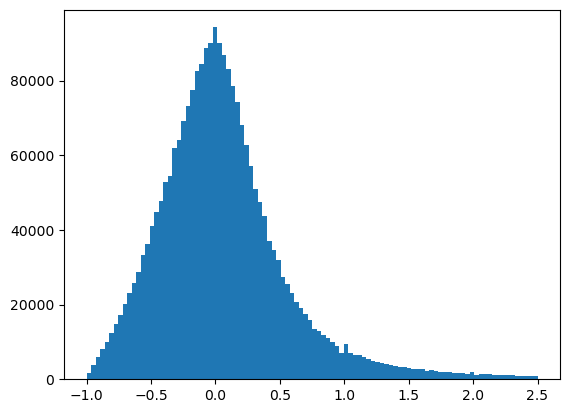

In [41]:
plt.hist(io['1yr_return'], bins=100, range=[-1,2.5])

It appears that the 3\*std mark is at approx. 250% return. Therefore, let's just look at the relationships within this range. Furthermore, due to the high density of points, let's use a heatmap rather than a scatterplot.

In [31]:
fig, ax = plt.subplots(len(io.columns[:-1]), 1, figsize=(7, 500))

for i, col in enumerate(io.columns[:-1]):
    ub = io[col].median() + (5*median_abs_deviation(io[col], nan_policy='omit'))
    lb = io[col].median() - (5*median_abs_deviation(io[col], nan_policy='omit'))
    temp_df = io[np.logical_and(io[col] <= ub, io[col] >= lb)]
    temp_df = temp_df[temp_df['1yr_return'] <= 2.5]
    heatmap, xedges, yedges = np.histogram2d(temp_df[col][temp_df[col].notnull()], temp_df['1yr_return'][temp_df[col].notnull()].to_numpy(), bins=50)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    ax[i].imshow(heatmap.T, extent=extent, origin='lower', aspect='auto', cmap='afmhot')
    try:
        ax[i].set_title(f'{col}\n{glossary[col]["Ratio"]}\n{glossary[col]["Category"]}\n{glossary[col]["Formula"]}')
    except:
        ax[i].set_title(col)
    plt.subplots_adjust(hspace=0.4)

In [32]:
del temp_df  # saving memory

## Dimensionality Reduction

There are no clear univariate relationships as expected. Let's use dimensionality reduction (DR) to see if we can identify clusters of points where the target variable is higher. We will use t-SNE for its generally superior performance for identifying clear clusters. Also, DR will help us to identify whether there are distinct clusters of points with different characteristics, e.g., tech companies versus energy etc.

We will normalise using min-max to ensure equal weighting. And we will also only use points that are unique by gvkey and a-date to remove points with duplicate values for all of the financial ratios and thus reduce computational intensity (whilst retaining as much information as possible).

In [56]:
df_dr = df.copy()

Now, let's prepare the dataset for t-SNE. t-SNE does not do well with missing data. Therefore, let's remove columns where there are lots of missing data naturally (e.g. 3-year moving averages and dividend-related features). And then let's drop the remainder of missing data from all columns. Most we marked as 'delete' earlier. 

In [57]:
ratios = ['CAPEI', 'bm', 'evm', 'pe_op_basic', 'pe_op_dil', 'pe_exi', 'pe_inc',
       'ps', 'pcf', 'dpr', 'npm', 'opmbd', 'opmad', 'gpm', 'ptpm', 'cfm',
       'roa', 'roe', 'roce', 'efftax', 'aftret_eq', 'aftret_invcapx',
       'aftret_equity', 'pretret_noa', 'pretret_earnat', 'GProf',
       'equity_invcap', 'debt_invcap', 'totdebt_invcap', 'capital_ratio',
       'int_debt', 'int_totdebt', 'cash_lt', 'invt_act', 'rect_act', 'debt_at',
       'debt_ebitda', 'short_debt', 'curr_debt', 'lt_debt', 'profit_lct',
       'ocf_lct', 'cash_debt', 'fcf_ocf', 'lt_ppent', 'dltt_be', 'debt_assets',
       'debt_capital', 'de_ratio', 'intcov', 'intcov_ratio', 'cash_ratio',
       'quick_ratio', 'curr_ratio', 'cash_conversion', 'inv_turn', 'at_turn',
       'rect_turn', 'pay_turn', 'sale_invcap', 'sale_equity', 'sale_nwc',
       'rd_sale', 'adv_sale', 'staff_sale', 'accrual', 'ptb', 'PEG_trailing',
       'divyield']

In [58]:
cols_to_drop = []
cols_to_keep = []

for i, value in enumerate(io[ratios].isnull().sum()):
    if value > 150000:
        cols_to_drop.append(io[ratios].columns[i])
    else:
        cols_to_keep.append(io[ratios].columns[i])

In [59]:
cols_to_keep

['bm',
 'evm',
 'ps',
 'pcf',
 'npm',
 'opmbd',
 'opmad',
 'gpm',
 'ptpm',
 'roa',
 'roce',
 'aftret_eq',
 'aftret_invcapx',
 'aftret_equity',
 'GProf',
 'equity_invcap',
 'debt_invcap',
 'totdebt_invcap',
 'capital_ratio',
 'cash_lt',
 'debt_at',
 'debt_ebitda',
 'lt_debt',
 'cash_debt',
 'lt_ppent',
 'dltt_be',
 'debt_assets',
 'debt_capital',
 'de_ratio',
 'at_turn',
 'sale_invcap',
 'sale_equity',
 'rd_sale',
 'adv_sale',
 'staff_sale',
 'accrual',
 'ptb',
 'divyield']

In [60]:
def clean_dr(df_dr, sample='sample'):
    X = df_dr.drop(columns = cols_to_drop).copy()
    X = X.dropna(how='any')
    print(len(df_dr), len(X))
    if sample == 'sample':
        X = X.drop_duplicates(subset=['gvkey', 'adate']).sample(frac=0.1, random_state=777)
    else:
        X = X.drop_duplicates(subset=['gvkey', 'adate'])
    print(len(X))
    df = X
    Y = X['1yr_return'].to_numpy()
    X = X[cols_to_keep].apply(lambda iterator: (iterator - np.min(iterator)) / (np.max(iterator) - np.min(iterator)))
    X = X.to_numpy()
    return X, Y, df

X, Y, df_X = clean_dr(df_dr)

2498891 2038168
18702


In [61]:
from sklearn.manifold import TSNE
import time
import random

time_start = time.time()
    
tsne = TSNE(random_state=777, perplexity=100).fit_transform(X)
print(time.time() - time_start)

164.06325030326843


(array([  29.,   63.,  100.,  128.,  171.,  221.,  212.,  299.,  363.,
         368.,  502.,  538.,  579.,  647.,  685.,  855.,  795.,  866.,
         934.,  849., 1069.,  854.,  883.,  810.,  688.,  646.,  466.,
         489.,  386.,  326.,  284.,  260.,  222.,  202.,  154.,  155.,
         129.,  104.,  106.,   88.,  104.,   61.,   54.,   54.,   50.,
          50.,   41.,   39.,   46.,   41.]),
 array([-1.  , -0.95, -0.9 , -0.85, -0.8 , -0.75, -0.7 , -0.65, -0.6 ,
        -0.55, -0.5 , -0.45, -0.4 , -0.35, -0.3 , -0.25, -0.2 , -0.15,
        -0.1 , -0.05,  0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,
         0.35,  0.4 ,  0.45,  0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,
         0.8 ,  0.85,  0.9 ,  0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ,
         1.25,  1.3 ,  1.35,  1.4 ,  1.45,  1.5 ]),
 <BarContainer object of 50 artists>)

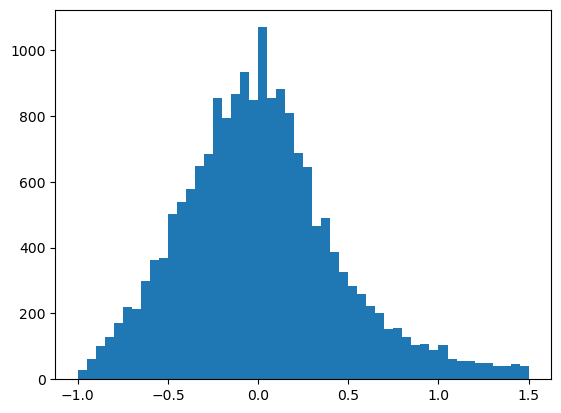

In [62]:
plt.hist(Y, bins=50, range=[-1, 1.5])

To make the diverging scale have a midpoint at 0 and as 10% is considered a strong return, we will cap the returns at -0.1 and 0.1 on the colourscale

In [63]:
Y[Y<=0] = 0.0
Y[Y>0] = 1.0
Y = Y.astype('str')
Y[Y == '0.0'] = 'Negative Returns'
Y[Y == '1.0'] = 'Positive Returns'

Let's also convert the tnse output to plotable x and y values.

In [64]:
def column(matrix, i):
    return [row[i] for row in matrix]

x = column(tsne, 0)
y = column(tsne, 1)

In [65]:
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com


In [66]:
df_X['x'] = x
df_X['y'] = y

In [69]:
import plotly.express as px

fig = px.scatter(df_X, x='x', y='y', color=Y, color_discrete_map={'Negative Returns': 'red', 'Positive Returns': 'green'}, hover_data=['SecurityNm', 'TICKER', '1yr_inf_rate', '1yr_GDP', 'DGS10', 'FEDFUNDS', 'public_date'])

fig.update_layout(plot_bgcolor='white')
fig.update_traces(marker=dict(size=3, cmax=0.3, cmin=-1))
           
fig.show()

This is very difficult to interpret as the algorithm has grouped together points with the same public_date. This could be because of the same/similar macro features or because stocks at this time shared some characteristics. Furthermore, there is not much green and red clustering. This is to be expected as the data consists of timestamps from 1970-2022. There were many different economic environments in this time and stocks performed better in some than others. Therefore, let's look at whether there is any separation for timestamps from a single year period. Let's choose a relatively normal year in 2017.

Furthermore, we are interested in differences in the financial ratios so let's remove the economic indicators and market cap so we are left with just financial ratios.

In [136]:
for col in ['MthCap','FEDFUNDS','1yr_inf_rate','1mo_inf_rate','1yr_GDP','1mo_GDP','DGS10','1yr_return']:
    cols_to_keep.remove(col)

In [148]:
def clean_dr(df_dr):
    X = df_dr.drop(columns = cols_to_drop)
    X = X.dropna(how='any')
    df = X
    Y = X['1yr_return'].to_numpy()
    X = X.loc[:, cols_to_keep]
    X = X.to_numpy()
    print(len(df_dr), len(X))
    return X, Y, df

In [149]:
df_dr['public_date'] = pd.to_datetime(df_dr['public_date'])
X, Y, df_X = clean_dr(df_dr[df_dr['public_date'] == pd.to_datetime('2017-01-31')])

3157 2772


In [150]:
time_start = time.time()

tsne = TSNE(random_state=777, perplexity=600).fit_transform(X)
print(time.time() - time_start)

66.08988738059998


(array([  0.,   0.,   3.,   9.,  11.,   8.,  12.,  20.,  25.,  23.,  31.,
         44.,  62.,  49.,  76.,  66.,  75., 122., 157., 169., 175., 178.,
        168., 168., 140., 131., 120., 104.,  86.,  75.,  50.,  41.,  54.,
         40.,  28.,  23.,  19.,  13.,  15.,  13.,  10.,  15.,   8.,  11.,
          6.,   4.,   6.,   7.,   5.,   5.]),
 array([-1.  , -0.95, -0.9 , -0.85, -0.8 , -0.75, -0.7 , -0.65, -0.6 ,
        -0.55, -0.5 , -0.45, -0.4 , -0.35, -0.3 , -0.25, -0.2 , -0.15,
        -0.1 , -0.05,  0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,
         0.35,  0.4 ,  0.45,  0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,
         0.8 ,  0.85,  0.9 ,  0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ,
         1.25,  1.3 ,  1.35,  1.4 ,  1.45,  1.5 ]),
 <BarContainer object of 50 artists>)

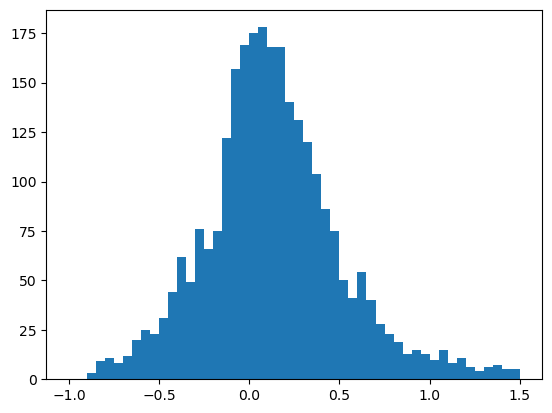

In [151]:
plt.hist(Y, bins=50, range=[-1, 1.5])

In [152]:
Y[Y<=0] = 0
Y[Y>0] = 1
Y = Y.astype('str')

In [153]:
def column(matrix, i):
    return [row[i] for row in matrix]

x = column(tsne, 0)
y = column(tsne, 1)

In [154]:
df_X['x'] = x
df_X['y'] = y

In [155]:
import plotly.express as px

fig = px.scatter(df_X, x='x', y='y', color=Y, color_discrete_map={'0.0': 'red', '1.0': 'green'}, hover_data=['SecurityNm', 'TICKER', '1yr_inf_rate', '1yr_GDP', 'DGS10', 'FEDFUNDS', 'public_date'])

fig.update_layout(plot_bgcolor='white')
fig.update_traces(marker=dict(size=3, cmax=0.3, cmin=-1))
           
fig.show()

Even after trying increasing levels of perplexity, there is not too much separation in the clusters. There is however clustering of financial companies and of therapeutics/pharmaceutical companies, implying that they have similar financial characteristics to each other.

## Change in Macroeconomic Indicators

Let's have a look at the change in macroeconomic conditions over time. This is important to understand the context of each period. Stocks with different fundamental characteristics may perform differently in different markets. First let's import the datasets.

In [45]:
gdp = wr.s3.read_csv('s3://dsp-data-vq22301/macro-data/gdp_add_columns.csv')
int_rate = wr.s3.read_csv('s3://dsp-data-vq22301/macro-data/int_rate_add_columns.csv')
inf = wr.s3.read_csv('s3://dsp-data-vq22301/macro-data/inf_add_columns.csv')
bond = wr.s3.read_csv('s3://dsp-data-vq22301/macro-data/bond_add_columns.csv')

Next, let's convert them into a single df for visualising over time.

In [46]:
for econ_df in [int_rate, inf, gdp, bond]:
    econ_df.DATE = pd.to_datetime(econ_df['DATE'])
    
gdp = gdp.set_index('DATE').resample('D').ffill()
int_rate = int_rate.set_index('DATE').resample('D').ffill()
inf = inf.set_index('DATE').resample('D').ffill()
bond = bond.set_index('DATE')

In [47]:
dfs = [gdp, int_rate, inf, bond]

for i, ma in enumerate(dfs):
    dfs[i] = ma.reset_index().drop(columns='Unnamed: 0')
    
gdp, int_rate, inf, bond = dfs
macro_df = gdp.merge(pd.merge(int_rate, inf, on='DATE'), on='DATE').merge(bond, on='DATE')

In [48]:
macro_df.loc[:, ['1yr_inf_rate', '1yr_GDP']] = macro_df.loc[:, ['1yr_inf_rate', '1yr_GDP']] * 100

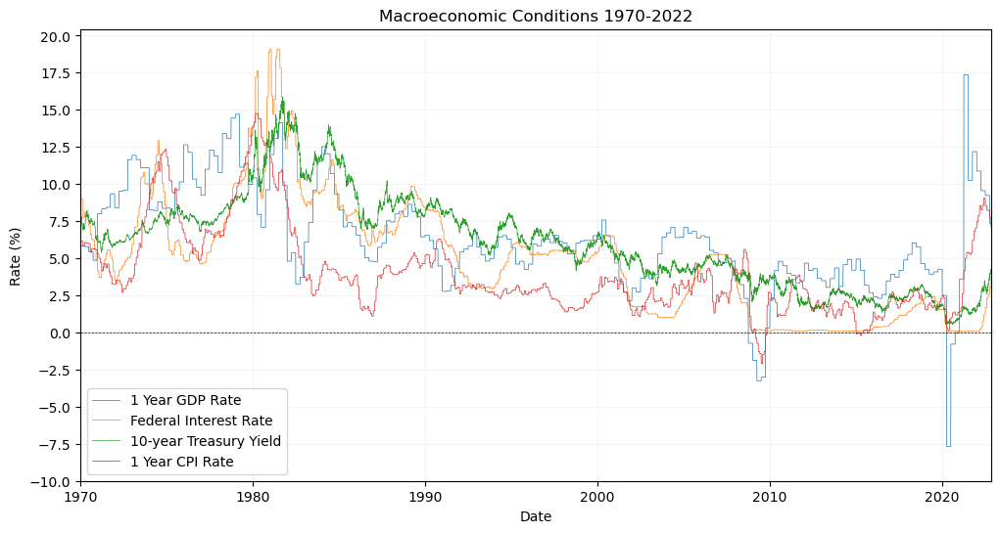

In [55]:
plt.figure(figsize=(12,6))
x = macro_df['DATE']
plt.plot(x, macro_df['1yr_GDP'], linewidth=0.5, label='1 Year GDP Rate')
plt.plot(x, macro_df['FEDFUNDS'], linewidth=0.5, label='Federal Interest Rate')
plt.plot(x, macro_df['DGS10'], linewidth=0.5, label='10-year Treasury Yield')
plt.plot(x, macro_df['1yr_inf_rate'], linewidth=0.5, label='1 Year CPI Rate')
plt.axhline(0,linestyle='--', color='k', linewidth=0.5)
plt.grid(color='#F5F5F5')
plt.legend(loc='best')
plt.yticks(ticks=np.arange(-10, 22.5, 2.5))
plt.title('Macroeconomic Conditions 1970-2022')
plt. margins(x=0)
plt.xlabel('Date')
plt.ylabel('Rate (%)')
plt.show()

## Companies

There are a large number of companies in our dataset. Let's have a look how unique companies we have and how many there are in each year (using adate).

In [135]:
len(df.gvkey.unique())

20878

So there are 20,878 unique companies in the dataset. Let's look at this over time, as companies are incorporated and liquidated over time.

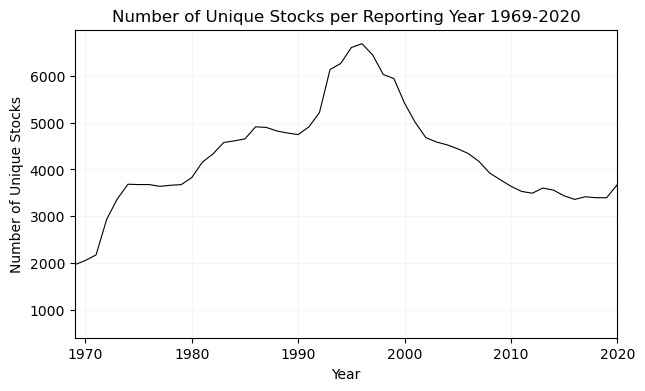

In [92]:
df['adate'] = pd.to_datetime(df['adate'])
df['ayear'] = df['adate'].dt.year
df_nco = df[['ayear', 'gvkey']].groupby(['ayear']).nunique()
plt.figure(figsize=(7, 4))
plt.plot(df_nco.index, df_nco['gvkey'], linewidth=0.8, color='k')
plt.grid(color='#F5F5F5')
plt.title('Number of Unique Stocks per Reporting Year 1969-2020')
plt.margins(x=0)
plt.xlim(1969, 2020)
plt.ylabel('Number of Unique Stocks')
plt.xlabel('Year')
plt.show()

Lots of companies seem to have been incorporated in the mid-late 1990s, which coincides with the dotcom boom. There is also a large jump at the start of the 1970s.

As companies are only in the dataset for a finite length of time and we plan to use sequential induction methods, let's investigate the distribution of length of time companies are in the dataset for.

In [94]:
for i, co in enumerate(df.gvkey.unique()):
    temp_df = df[df['gvkey'] == co]
    period = pd.to_datetime(temp_df['public_date']).sort_values(ascending=True)
    length = (period.iloc[-1] - period.iloc[0]) / pd.Timedelta(days=365)
    if i == 0:
        length_df = pd.DataFrame(data=[[length, temp_df['TICKER'].iloc[0]]], columns=['Length', 'TICKER'], index=[co])
    else:
        temp_length = pd.DataFrame(data=[[length, temp_df['TICKER'].iloc[0]]], columns=['Length', 'TICKER'], index=[co])
        length_df = pd.concat([length_df, temp_length])

In [95]:
length_df.sort_values(by='Length', ascending=False)

,Length,TICKER
"8,479.0000",51.8740,PEP
"8,151.0000",51.8740,ONG
"6,502.0000",51.8740,KR
"8,099.0000",51.8740,OEC
"4,941.0000",51.8740,GMT
...,...,...
"11,826.0000",0.0000,BSCC
"139,803.0000",0.0000,OMNY
"11,936.0000",0.0000,ABCI
"62,908.0000",0.0000,MJK


And full timespan of dataset is...

In [96]:
(pd.to_datetime(df['public_date'].unique()).sort_values(ascending=True)[-1] - pd.to_datetime(df['public_date'].unique()).sort_values(ascending=True)[0]) / pd.Timedelta(days=365)

AttributeError: 'DatetimeArray' object has no attribute 'sort_values'

So there are some companies which span the whole dataset and some that only have a single datapoint. Let's map the distribution.

Text(0, 0.5, 'Proportion of Stocks')

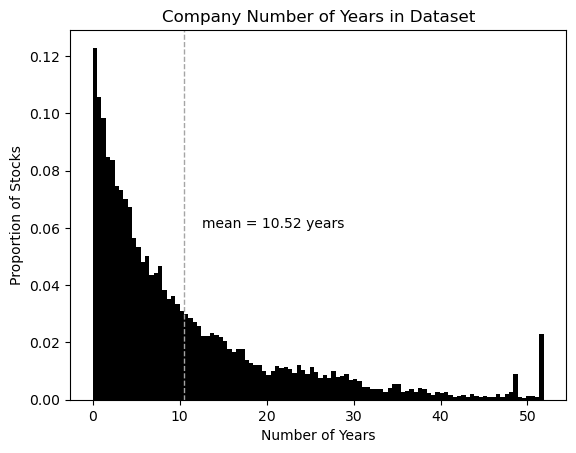

In [105]:
fig, ax = plt.subplots(1, 1)
mu = length_df['Length'].mean()
ax.hist(length_df['Length'], bins=104, density=True, color='k')
ax.axvline(x=mu, color='#A5A5A5', linestyle='--', linewidth=1)
ax.annotate(f'mean = {"{:.2f}".format(mu)} years', xy=(mu+2, 0.06))
plt.title('Company Number of Years in Dataset')
plt.xlabel('Number of Years')
plt.ylabel('Proportion of Stocks')

## Market Cap

The returns for smaller companies are likely to be more volatile than for larger companies. Let's explore the size of the companies in our dataset. Let's look at the top largest and smallest companies by their average market cap...

In [94]:
df_mc = df[['gvkey', 'MthCap', 'TICKER']].groupby(['TICKER', 'gvkey']).mean()
df_mc.reset_index().sort_values(by='MthCap', ascending=False)

,TICKER,gvkey,MthCap
10197,GOOGL,"160,329.0000","357,051,957.2251"
25954,XOM,"4,503.0000","337,998,472.0788"
15656,MSFT,"12,141.0000","336,682,489.1701"
8433,FB,"170,617.0000","315,309,938.6508"
1335,AMZN,"64,768.0000","267,693,862.1675"
...,...,...,...
7333,DYIN,"4,122.0000",375.7811
1737,ARON,"1,077.0000",357.8048
17019,OAIR,"8,072.0000",350.6900
24116,UIND,"10,820.0000",334.0374


As expected, the largest companies by average market cap (000s) are the notorious US big tech companies and Exxon (XOM). The average market caps range from 100s of thousands to 100s of billions. Let's just look at the range of market caps that lie within the 4.5*MAD marks to get a picture of the distribution of company sizes.

Text(0.5, 0, 'Market Capitalisation (000s)')

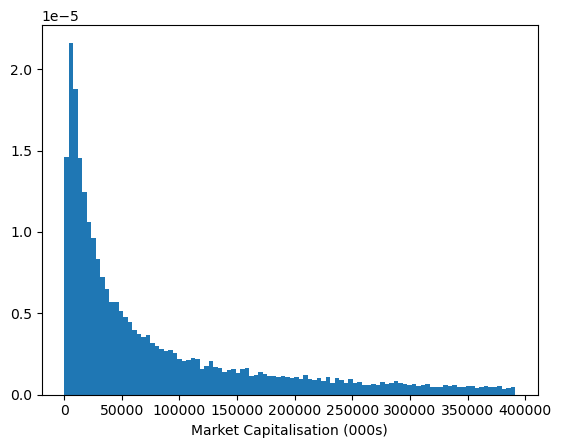

In [97]:
from scipy.stats import median_abs_deviation

df_mc = df_mc.copy().reset_index()
ub = df_mc['MthCap'].median() + (4.5*median_abs_deviation(df_mc['MthCap'], nan_policy='omit'))
lb = df_mc['MthCap'].median() - (4.5*median_abs_deviation(df_mc['MthCap'], nan_policy='omit'))
temp_df = df_mc[np.logical_and(df_mc['MthCap'] <= ub, df_mc['MthCap'] >= lb)]
plt.hist(temp_df['MthCap'], bins=100, density=True)
plt.xlabel('Market Capitalisation (000s)')

In [113]:
print('Mean =', "{:,.0f}".format(df_mc['MthCap'].mean())+',000')

Mean = 1,091,224,000


The distribution of market cap follows a power law with the mean much greater than the median + 4.5*MAD. This is to be expected due to a large portion of the overall North American market cap being made up by just a few very large companies (e.g. FANG).

It would be useful to bucket the stocks into caps. Before we can, we need to decide on cap cut-offs for each year of the dataset, as what is considered to fit in each category changes over time.

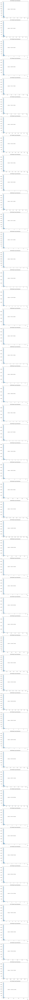

In [5]:
Fig, ax = plt.subplots(len(range(1970, 2022)), 1, figsize=(8, 300))
for i, year in enumerate(range(1970, 2022)):
    series = df[pd.to_datetime(df['public_date']).dt.year == year][['gvkey','MthCap']].groupby('gvkey').mean()
    ax[i].hist(series, bins=100)
    ax[i].set_title(f'{year} Market Cap Distribution')
    ax[i].axvline(x=series.median()[0], color='k', linestyle='--', linewidth=1)
    ax[i].annotate(f'median = {"{:.2f}".format(series.median()[0])} (000s)', xy=(ax[i].get_xlim()[1]/6, ax[i].get_ylim()[1]/2))

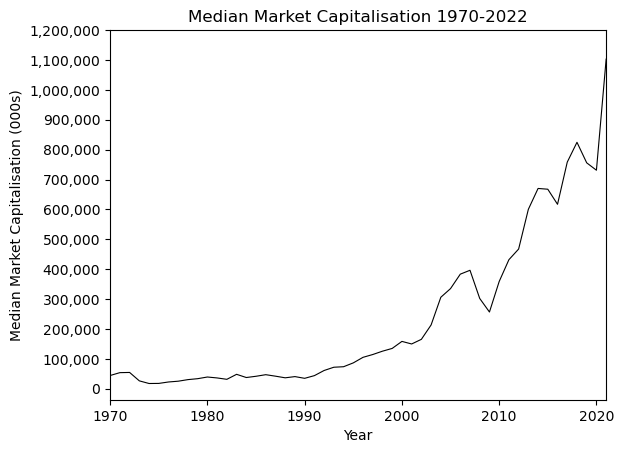

In [36]:
yr_medians = df[['public_date','gvkey','MthCap']].groupby([df['public_date'].dt.year, 'gvkey']).mean()['MthCap'].groupby('public_date').median()
yr_medians.plot(color='k', linewidth=0.8)
yticks = plt.yticks(np.arange(0, 1300000, 100000))
current_values = plt.gca().get_yticks()
plt.gca().set_yticklabels(['{:,.0f}'.format(x) for x in current_values])
plt.title('Median Market Capitalisation 1970-2022')
plt.xlabel('Year')
plt.ylabel('Median Market Capitalisation (000s)')
plt.margins(x=0)

After reviewing the distribution, it appears that the power law remains over time but the values scale greatly as expected. Therefore, we will use the current cut-offs but scaled down according to the ratio of the median in that year to the median in 2021. Although this is approximate, it suits our needs.

Let's add this to the dataset...

In [ ]:
market_cap_dict = {year:{cap:np.nan for cap in ['Median', 'Nano Cap', 'Micro Cap', 'Small Cap', 'Mid Cap', 'Large Cap', 'Mega Cap']} for year in range(1970, 2022)}

for cap, size in [('Nano Cap', 50000), ('Micro Cap', 300000), ('Small Cap', 2000000), ('Mid Cap', 10000000), ('Large Cap', 200000000), ('Mega Cap', 10000000000)]:
    market_cap_dict[2021][cap] = size

market_cap_dict[2021]['Median'] = df[pd.to_datetime(df['public_date']).dt.year == 2021][['gvkey','MthCap']].groupby('gvkey').mean().median()[0]

base = market_cap_dict[2021]['Median']

for year in range(1970, 2022):
    median = df[pd.to_datetime(df['public_date']).dt.year == year][['gvkey','MthCap']].groupby('gvkey').mean().median()[0]
    market_cap_dict[year]['Median'] = median
    ratio = median/base
    for cap in ['Nano Cap', 'Micro Cap', 'Small Cap', 'Mid Cap', 'Large Cap', 'Mega Cap']:
        market_cap_dict[year][cap] = market_cap_dict[2021][cap] * ratio
        
for i, year in enumerate(range(1970, 2022)):
    year_copy = df[pd.to_datetime(df['public_date']).dt.year == year].copy()
    year_copy['cap'] = pd.cut(year_copy['MthCap'], [0, market_cap_dict[year]['Nano Cap'], market_cap_dict[year]['Micro Cap'], market_cap_dict[year]['Small Cap'], market_cap_dict[year]['Mid Cap'], market_cap_dict[year]['Large Cap'], market_cap_dict[year]['Mega Cap']], labels=['Nano Cap', 'Micro Cap', 'Small Cap', 'Mid Cap', 'Large Cap', 'Mega Cap'])
    df.loc[year_copy.index, 'cap'] = year_copy['cap']

In [ ]:
wr.s3.to_csv(df=df, path='s3://dsp-data-vq22301/final_dataset_with_cap.csv')

Let's look at the proportion of each cap in the whole dataset.

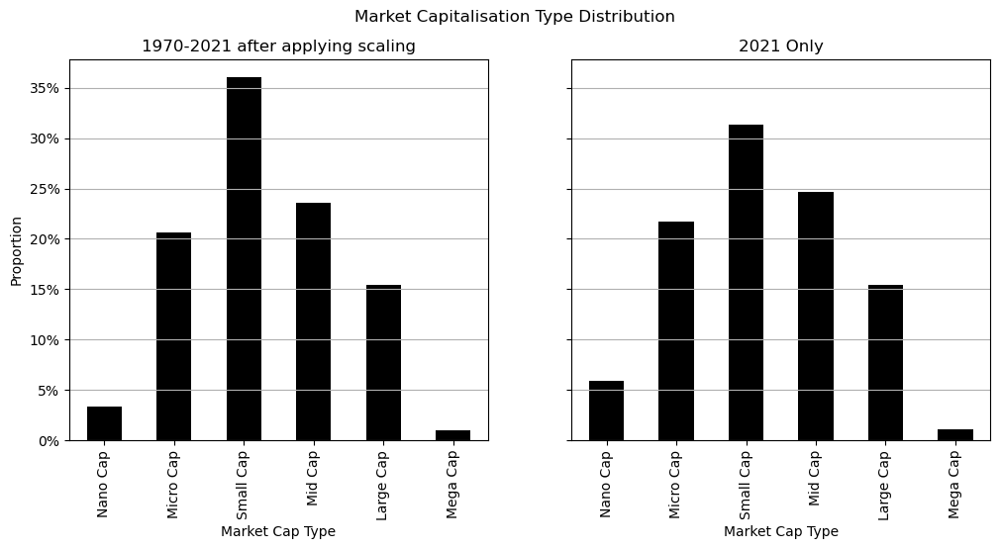

In [84]:
Fig, ax = plt.subplots(1, 2, figsize=(12, 5), sharey=True)
caps = ['Nano Cap', 'Micro Cap', 'Small Cap', 'Mid Cap', 'Large Cap', 'Mega Cap']

all_yrs = df.groupby('cap')['cap'].count().loc[caps]
cap_21 = df[df['public_date'].dt.year == 2021].groupby('cap')['cap'].count().loc[caps]
((all_yrs/all_yrs.sum())*100).plot(kind='bar', ax=ax[0], color='k')
((cap_21/cap_21.sum())*100).plot(kind='bar', ax=ax[1], color='k')
ax[0].set_title('1970-2021 after applying scaling')
ax[1].set_title('2021 Only')
for axes in ax:
    axes.set_xlabel('Market Cap Type')
    axes.set_ylabel('Proportion')
    axes.grid(axis='y')
plt.suptitle('Market Capitalisation Type Distribution')
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(decimals=0))

## Returns

let's look at the target variable (1yr return). First, let's see how it changes on average over time. This is important to bear in mind as the returns our model generates are likely to vary with the average market return.

In [112]:
df_ret.mean()[0]

0.15144618856738556

In [223]:
df_ret = df[['public_date', '1yr_return']].groupby(['public_date']).mean()

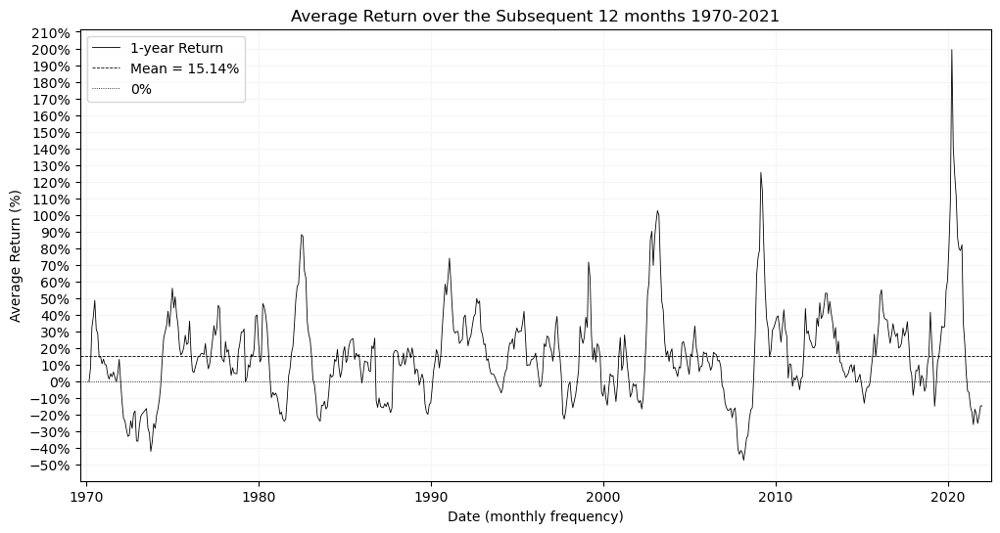

In [232]:
plt.figure(figsize=(12, 6))
plt.plot(pd.to_datetime(df_ret.index), df_ret['1yr_return']*100, linewidth=0.6, color='k', label='1-year Return')
mean = df_ret.mean()[0]*100
plt.axhline(y=mean, color='k', linestyle='--', linewidth=0.6, label=f'Mean = {round(mean, 2)}%')
plt.grid(color='#F5F5F5')
plt.title('Average Return over the Subsequent 12 months 1970-2021')
plt.axhline(y=0, color='k', linestyle=':', linewidth=0.6, label='0%')
plt.yticks(ticks=np.arange(-50, 220, 10))
plt.ylabel('Average Return (%)')
plt.xlabel('Date (monthly frequency)')
plt.legend(loc='best')
plt.margins(x=0.01)
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(decimals=0))
plt.show()

We can see that there is lots of fluctuation in our target variable over time. Let's see how this varies with market cap. We will bin companies into small, mid, and large cap companies.

In [180]:
def get_column(index, col):
    return [row[col] for row in index]

cap_returns = df[['public_date', 'cap', '1yr_return']].groupby(['public_date', 'cap']).mean()
ordered_cap_returns = (cap_returns.loc[get_column(cap_returns.index, 0), caps, :]*100).reset_index()

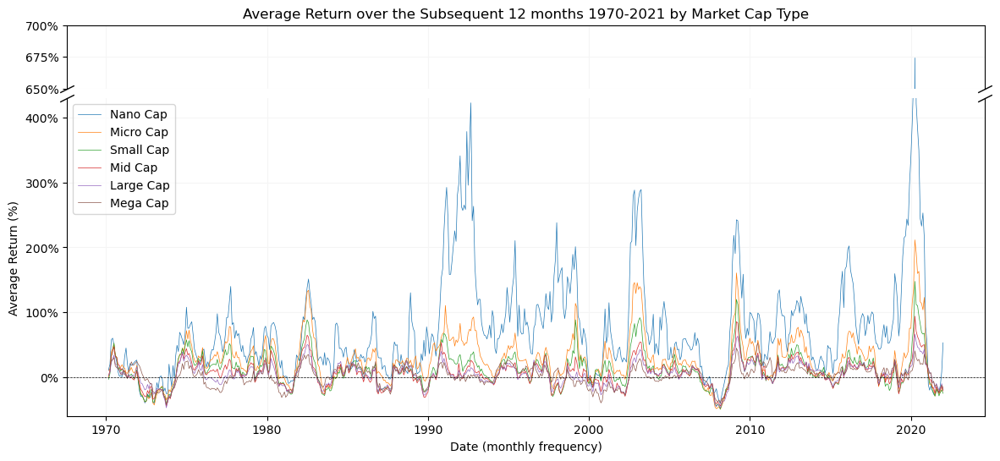

In [235]:
fig, ax = plt.subplots(2, 1, sharex=True, height_ratios=[1, 5], figsize=(14, 6))
fig.subplots_adjust(hspace=0.05)

for axes in ax:
    for cap in ordered_cap_returns['cap'].unique():
        axes.plot(pd.to_datetime(np.sort(ordered_cap_returns['public_date'].unique())), ordered_cap_returns['1yr_return'][ordered_cap_returns['cap'] == cap], linewidth=0.5, label=cap)
        axes.yaxis.set_major_formatter(mtick.PercentFormatter(decimals=0))
        axes.grid(color='#F5F5F5')

ax[1].set_ylim(-60, 430)
ax[0].set_ylim(650, 700)

ax[0].spines.bottom.set_visible(False)
ax[1].spines.top.set_visible(False)
ax[0].tick_params(bottom=None)
ax[1].xaxis.tick_bottom()
d = .5
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax[0].plot([0, 1], [0, 0], transform=ax[0].transAxes, **kwargs)
ax[1].plot([0, 1], [1, 1], transform=ax[1].transAxes, **kwargs)
ax[1].legend(loc='best')
ax[1].set_xlabel('Date (monthly frequency)')
ax[1].set_ylabel('Average Return (%)')
ax[1].axhline(y=0, color='k', linestyle='--', linewidth=0.5)
ax[0].set_title('Average Return over the Subsequent 12 months 1970-2021 by Market Cap Type')
plt.show()

On average, it can be seen that the smaller the market cap, on average, the greater the volatility in the target variable, 1yr return. 2020 stands out as an anomaly for smaller-cap companies, with returns averaging nearly 600% for Nano Cap companies. This reflects the strong rebounding of market confidence in tech and the lockdown boom following the initial COVID-19 outbreak.

## Feature Correlation

With >60 financial ratios, many of them are very similar and would convey very similar information to a model. Therefore, let's label each by its category and examine the correlation between them. Let's start by dropping any nan values as these are likely to skew the correlation in figures and the resulting dataset should still easily retain enough observations to accurately assess correlation. 

In [54]:
df_crmx = io.copy().dropna(how='any')

In [58]:
len(df_crmx)

151380

In [55]:
for col in io.columns:
    try:
        df_crmx = df_crmx.rename(columns={col: f'{col} - ' + f'{glossary[col]["Ratio"]} - ' + f'{glossary[col]["Category"]}'.upper()})
    except:
        pass

In [56]:
df_crmx.head()

,CAPEI - Shillers Cyclically Adjusted P/E Ratio - VALUATION,bm - Book/Market - VALUATION,evm - Enterprise Value Multiple - VALUATION,"pe_op_basic - Price/Operating Earnings (Basic, Excl. EI) - VALUATION","pe_op_dil - Price/Operating Earnings (Diluted, Excl. EI) - VALUATION","pe_exi - P/E (Diluted, Excl. EI) - VALUATION","pe_inc - P/E (Diluted, Incl. EI) - VALUATION",ps - Price/Sales - VALUATION,pcf - Price/Cash flow - VALUATION,dpr - Dividend Payout Ratio - VALUATION,npm - Net Profit Margin - PROFITABILITY,opmbd - Operating Profit Margin Before Depreciation - PROFITABILITY,opmad - Operating Profit Margin After Depreciation - PROFITABILITY,gpm - Gross Profit Margin - PROFITABILITY,ptpm - Pre-tax Profit Margin - PROFITABILITY,cfm - Cash Flow Margin - FINANCIAL SOUNDNESS,roa - Return on Assets - PROFITABILITY,roe - Return on Equity - PROFITABILITY,roce - Return on Capital Employed - PROFITABILITY,efftax - Effective Tax Rate - PROFITABILITY,aftret_eq - After-tax Return on Average Common Equity - PROFITABILITY,aftret_invcapx - After-tax Return on Invested Capital - PROFITABILITY,aftret_equity - After-tax Return on Total Stockholders’ Equity - PROFITABILITY,pretret_noa - Pre-tax return on Net Operating Assets - PROFITABILITY,pretret_earnat - Pre-tax Return on Total Earning Assets - PROFITABILITY,GProf - Gross Profit/Total Assets - PROFITABILITY,equity_invcap - Common Equity/Invested Capital - CAPITALISATION,debt_invcap - Long-term Debt/Invested Capital - CAPITALISATION,totdebt_invcap - Total Debt/Invested Capital - CAPITALISATION,capital_ratio - Capitalization Ratio - CAPITALISATION,int_debt - Interest/Average Long-term Debt - FINANCIAL SOUNDNESS,int_totdebt - Interest/Average Total Debt - FINANCIAL SOUNDNESS,cash_lt - Cash Balance/Total Liabilities - FINANCIAL SOUNDNESS,invt_act - Inventory/Current Assets - FINANCIAL SOUNDNESS,rect_act - Receivables/Current Assets - FINANCIAL SOUNDNESS,debt_at - Total Debt/Total Assets - SOLVENCY,debt_ebitda - debt_ebitda - FINANCIAL SOUNDNESS,short_debt - Short-Term Debt/Total Debt - FINANCIAL SOUNDNESS,curr_debt - Current Liabilities/Total Liabilities - FINANCIAL SOUNDNESS,lt_debt - Long-term Debt/Total Liabilities - FINANCIAL SOUNDNESS,profit_lct - Profit Before Depreciation/Current Liabilities - FINANCIAL SOUNDNESS,ocf_lct - Operating CF/Current Liabilities - FINANCIAL SOUNDESS,cash_debt - Cash Flow/Total Debt - FINANCIAL SOUNDNESS,fcf_ocf - Free Cash Flow/Operating Cash Flow - FINANCIAL SOUNDNESS,lt_ppent - Total Liabilities/Total Tangible Assets - FINANCIAL SOUNDNESS,dltt_be - Long-term Debt/Book Equity - FINANCIAL SOUNDESS,debt_assets - Total Debt/Total Assets - SOLVENCY,debt_capital - Total Debt/Capital - SOLVENCY,de_ratio - Total Debt/Equity - SOLVENCY,intcov - After-tax Interest Coverage - SOLVENCY,intcov_ratio - Interest Coverage Ratio - SOLVENCY,cash_ratio - Cash Ratio - LIQUIDITY,quick_ratio - Quick Ratio (Acid Test) - LIQUIDITY,curr_ratio - Current Ratio - LIQUIDITY,cash_conversion - Cash Conversion Cycle (Days) - LIQUIDITY,inv_turn - Inventory Turnover - EFFICIENCY,at_turn - Asset Turnover - EFFICIENCY,rect_turn - Receivables Turnover - EFFICIENCY,pay_turn - Payables Turnover - EFFICIENCY,sale_invcap - Sales/Invested Capital - EFFICIENCY,sale_equity - Sales/Stockholders Equity - EFFICIENCY,sale_nwc - Sales/Working Capital - EFFICIENCY,rd_sale - Research and Development/Sales - OTHER,adv_sale - Avertising Expenses/Sales - OTHER,staff_sale - Labor Expenses/Sales - OTHER,accrual - Accruals/Average Assets - OTHER,ptb - Price/Book - VALUATION,PEG_trailing - Trailing P/E to Growth (PEG) ratio - VALUATION,divyield - Dividend Yield - VALUATION,MthCap,FEDFUNDS,1yr_inf_rate,1mo_inf_rate,1yr_GDP,1mo_GDP,DGS10,1yr_return
461,22.7870,0.6860,7.6460,13.9490,14.1360,14.1360,14.1360,0.6300,20.2640,0.2250,0.0450,0.1030,0.0840,0.2070,0.0650,0.0640,0.1350,0.1180,0.1570,0.3030,0.1330,0.1170,0.1330,0.1840,0.1330,0.2620,0.6430,0.3570,0.3580,0.3570,0.1040,0.1030,0.0210,0.5990,0.3230,0.2500,1.9200,0.0020,0.4

Text(0.5, 1.0, 'Feature Correlation Matrix')

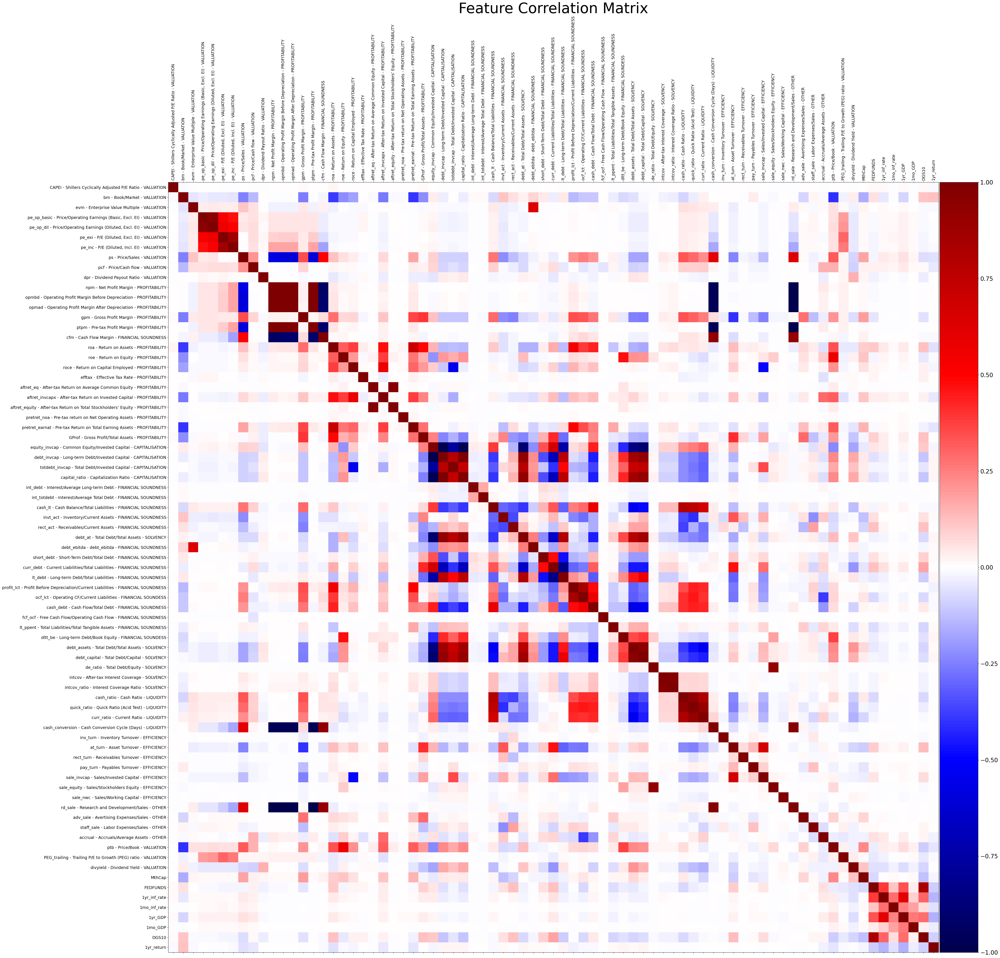

In [57]:
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable

Fig, ax = plt.subplots(1, 1, figsize=(50, 50))
im = ax.matshow(df_crmx.corr(), cmap=mpl.cm.seismic, vmin=-1, vmax=1)
plt.xticks(range(df_crmx.select_dtypes(['number']).shape[1]), df_crmx.select_dtypes(['number']).columns, fontsize=14, rotation=90)
plt.yticks(range(df_crmx.select_dtypes(['number']).shape[1]), df_crmx.select_dtypes(['number']).columns, fontsize=14)
norm = mpl.colors.Normalize(vmin=-1, vmax=1)
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=mpl.cm.seismic), cax=cax)
cb.ax.tick_params(labelsize=20)
ax.set_title('Feature Correlation Matrix', fontsize=50)

It can be seen that there is lots of correlation between variables. Image is saved and reviewed so that it can be zoomed in on and the relationships inspected. The results of examination draw the following conclusions:

 - FINANCIAL SOUNDNESS: Barring the two interest-related ratios (which are correlated to eachother), there is high correlation between the financial soundness ratios. Furthermore, there is correlation between some of the ratios and similar other ratios, e.g., ROA and the current/quick ratios.
 - VALUATION: There is high correlation between the P/E-related ratios as expected. Perhaps more surprisingly, the price/sales ratio is highly negatively correlated with profitability ratios. Book/market is negatively correlated with ROA and similar ratios. This is interesting because a company is more affordable (relative to its assets) if it makes less return on its assets.
 - PROFITABILITY: Many of the profitability ratios are essentially the same. Interestingly, four of the profitabilty ratios, including net profit margin, are highly negatively correlated with R&D/Sales. This maybe shows that if the net profit margin is high then they are not spending as much on R&D. And, in fact, if their R&D spend is high, then their net profit is eaten away at.
 - CAPITALISATION: Highly correlated with each other. Also, highly correlated with financial soundness and solvency ratios. This is perhaps expected; if a company has strong capitalisation metrics, it's likely to be financially sound and solvent and vice versa.
 - SOLVENCY: As is to be expected, high correlation for some with financial soundness and liquidity ratios.
 - LIQUIDITY: 
 
 